# MAP for Rochio's method 3 iterations





In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
ranking_vgg['1/1']

In [ ]:
sketch_ground_truth = {}
title_list = {}
for i in range(1, 34):
  sketch_ground_truth[i] = []
  title_list[i] = []
file = open("/content/drive/My Drive/IR/Flickr15K/list_images.txt", "r")

for line in file.readlines():
    line = line.strip('\n').split(" ")
    number = int(line[0])
    name = line[1].split(".")[0]
    if name not in sketch_ground_truth[number]:
      sketch_ground_truth[number].append(name)
    if name.split('/')[0] not in title_list[number]:
      title_list[number].append(name.split('/')[0])
file.close()

In [ ]:
sketch_relevent = {}
for i in range(1, 34):
  sketch_relevent[i] = 0
file = open("/content/drive/My Drive/IR/Flickr15K/list_images.txt", "r")
title_list = []
for line in file.readlines():
    line = line.strip('\n').split(" ")
    number = int(line[0])
    name = line[1].split("/")[0]
    sketch_relevent[number]+=1
file.close()

In [ ]:
sketch_ground_truth[1]

['fire_balloon/110181',
 'fire_balloon/129097',
 'fire_balloon/13794',
 'fire_balloon/138163',
 'fire_balloon/142476',
 'fire_balloon/142850',
 'fire_balloon/142984',
 'fire_balloon/143028',
 'fire_balloon/356485',
 'fire_balloon/356488',
 'fire_balloon/356491',
 'fire_balloon/356498',
 'fire_balloon/356557',
 'fire_balloon/366639',
 'fire_balloon/384541',
 'fire_balloon/390060',
 'fire_balloon/551831',
 'fire_balloon/551835',
 'fire_balloon/566962',
 'fire_balloon/60385',
 'fire_balloon/60388',
 'fire_balloon/73852',
 'fire_balloon/73863',
 'fire_balloon/81386',
 'fire_balloon/81393',
 'fire_balloon/90415',
 'fire_balloon/917248',
 'fire_balloon/917249',
 'fire_balloon/917254',
 'fire_balloon/947521',
 'fire_balloon/96346',
 'fire_balloon/96384',
 'fire_balloon/96539',
 'fire_balloon/97479',
 'fire_balloon/99016',
 'fire_balloon/990953',
 'London_eye/1001395',
 'London_eye/100246',
 'London_eye/1004885',
 'London_eye/1006701',
 'London_eye/1006751',
 'London_eye/1006928',
 'London_eye

In [ ]:
len(sketch_ground_truth[1])

1306

In [ ]:
def compute_MAP(actual,ranking):
  precision=[]
  recall=[]
  count=0;
  n=len(actual)
  for i in range(len(ranking)):
    
    arr=ranking[i][0].split('.')
    
    if arr[0] in actual:
      count+=1
      recall.append(count/n)
      precision.append(count/(i+1))
      # recall[count/n]=count/(i+1)
      # print(count,i)
    
  return (recall,precision)
  


In [ ]:
def AP(recall,precision):
  n=len(recall)
  j=0;
  p={}
  ap=0
  for i in range(10):
    for k in range(n):
      if(((i+1)*10)>(recall[k]*100)):
        continue
      else:
        # print(recall[k]*100)
        p[(i+1)*10]=precision[k]*100
        ap+=(precision[k]*100)
        break
  ap/=10
  return ap


##Without relevance feedback

##VGG16 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/Result/RankingVGG16.pkl','rb')
ranking_vgg=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg)
print("MAP = "+str(map))

MAP = 9.604570548744963


##InceptionV3 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/Result/RankingInceptionV3.pkl','rb')
ranking_vgg=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg)
print("MAP = "+str(map))

MAP = 9.475586613994734


##ResNet cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/Result/RankingResNet50.pkl','rb')
ranking_vgg=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg)
print("MAP = "+str(map))

MAP = 13.245891134302349


## With Relevance feedback

## VGG16_3 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_VGG16_3.pkl','rb')
ranking_vgg=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg)
print("MAP = "+str(map))

MAP = 49.644945121762


In [ ]:
len(ranking_vgg)

330

In [ ]:
# p=AP(recall,precision)

10.03062787136294
20.06125574272588
30.01531393568147
40.04594180704441
50.0
60.03062787136294
70.06125574272588
80.01531393568146
90.0459418070444
100.0


In [ ]:
def R_Precision(actual,ranking):
  r=0
  R=len(actual)
  for i in range(R):
    arr=ranking[i][0].split('.')
    
    if arr[0] in actual:
      r+=1
  r/=R
  return r

In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[71.66921898928025, 56.07675906183369, 53.34358186010761, 37.254901960784316, 76.24671916010499, 75.83333333333333, 36.885245901639344, 79.32752179327521, 67.5, 56.36363636363636, 76.91131498470948, 74.33962264150942, 55.643251775848455, 9.523809523809524, 56.22895622895623, 77.6595744680851, 48.369565217391305, 69.89247311827957, 55.06607929515418, 4.0, 50.0, 87.39495798319328, 31.343283582089555, 53.973509933774835, 58.97435897435898, 51.470588235294116, 44.800000000000004, 41.66666666666667, 31.03448275862069, 73.26388888888889, 45.21276595744681, 44.44444444444444, 33.15217391304348, 62.55742725880551, 56.39658848614072, 47.80937740199847, 28.431372549019606, 74.93438320209974, 76.66666666666667, 32.295081967213115, 82.81444582814446, 59.0, 54.54545454545454, 78.13455657492355, 58.11320754716981, 62.194159431728494, 9.523809523809524, 59.0347923681257, 75.31914893617021, 54.347826086956516, 61.29032258064516, 57.48898678414097, 6.0, 39.30232558139535, 83.19327731092437, 31.34328358

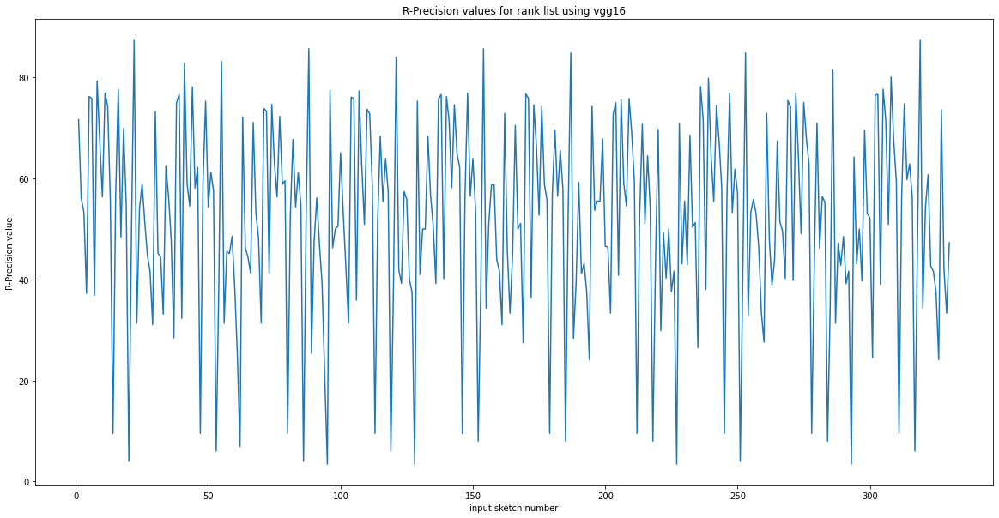

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using vgg16")
plt.show()


## InceptionV3_3 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_InceptionV3_3.pkl','rb')
ranking_vgg=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg)
print("MAP = "+str(map))

MAP = 55.94826341343685


## ResNet_3 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_ResNet_3.pkl','rb')
ranking_vgg=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg)
print("MAP = "+str(map))

MAP = 57.63306800006025


## VGG16_5 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_VGG16_5.pkl','rb')
ranking_vgg=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg)
print("MAP = "+str(map))

MAP = 54.527016828826184


In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[73.66003062787136, 60.447761194029844, 54.34281322059954, 40.19607843137255, 77.55905511811024, 79.16666666666666, 41.967213114754095, 81.25778331257784, 70.5, 65.45454545454545, 80.1223241590214, 74.71698113207546, 59.51065509076558, 14.285714285714285, 58.24915824915825, 79.57446808510639, 56.52173913043478, 68.27956989247312, 58.370044052863435, 4.0, 56.27906976744186, 86.5546218487395, 40.298507462686565, 54.80132450331126, 60.51282051282051, 51.470588235294116, 42.4, 37.5, 34.48275862068966, 80.20833333333334, 52.12765957446809, 44.44444444444444, 44.02173913043478, 68.91271056661562, 61.19402985074627, 50.88393543428133, 35.294117647058826, 76.24671916010499, 80.0, 40.32786885245901, 83.43711083437111, 61.5, 60.909090909090914, 81.34556574923548, 66.0377358490566, 63.85161799526441, 14.285714285714285, 59.25925925925925, 78.61702127659575, 61.41304347826087, 65.59139784946237, 58.81057268722467, 8.0, 48.372093023255815, 84.87394957983193, 40.298507462686565, 51.49006622516556, 5

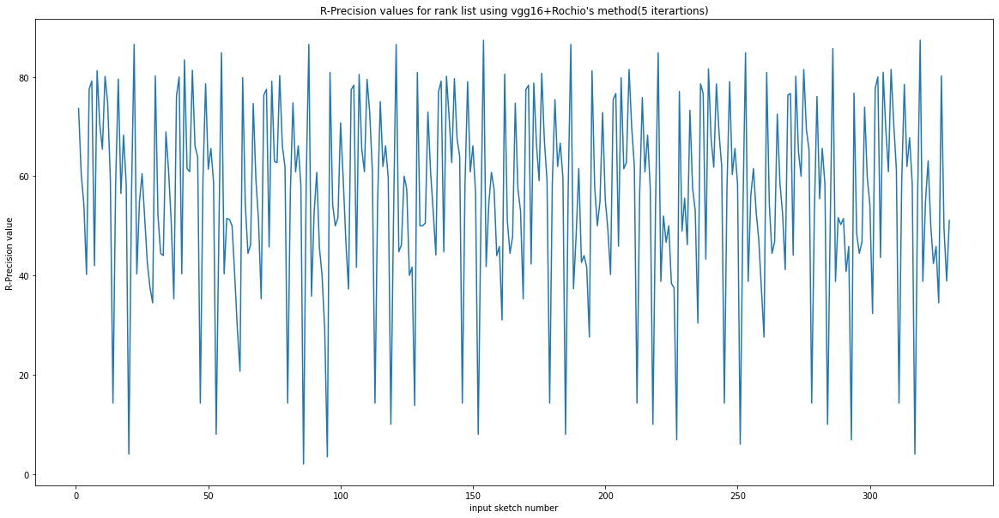

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using vgg16+Rochio's method(5 iterartions)")
plt.show()


##InceptionV3_5 cosine

In [ ]:
import pickle
file=open('/content/drive/My Drive/IR/new_Ranking/newSketchRanking_InceptionV3_5.pkl','rb')
ranking_inception=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_inception.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_inception)
print("MAP = "+str(map))

MAP = 64.15011254772553


In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_vgg.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[73.66003062787136, 60.447761194029844, 54.34281322059954, 40.19607843137255, 77.55905511811024, 79.16666666666666, 41.967213114754095, 81.25778331257784, 70.5, 65.45454545454545, 80.1223241590214, 74.71698113207546, 59.51065509076558, 14.285714285714285, 58.24915824915825, 79.57446808510639, 56.52173913043478, 68.27956989247312, 58.370044052863435, 4.0, 56.27906976744186, 86.5546218487395, 40.298507462686565, 54.80132450331126, 60.51282051282051, 51.470588235294116, 42.4, 37.5, 34.48275862068966, 80.20833333333334, 52.12765957446809, 44.44444444444444, 44.02173913043478, 68.91271056661562, 61.19402985074627, 50.88393543428133, 35.294117647058826, 76.24671916010499, 80.0, 40.32786885245901, 83.43711083437111, 61.5, 60.909090909090914, 81.34556574923548, 66.0377358490566, 63.85161799526441, 14.285714285714285, 59.25925925925925, 78.61702127659575, 61.41304347826087, 65.59139784946237, 58.81057268722467, 8.0, 48.372093023255815, 84.87394957983193, 40.298507462686565, 51.49006622516556, 5

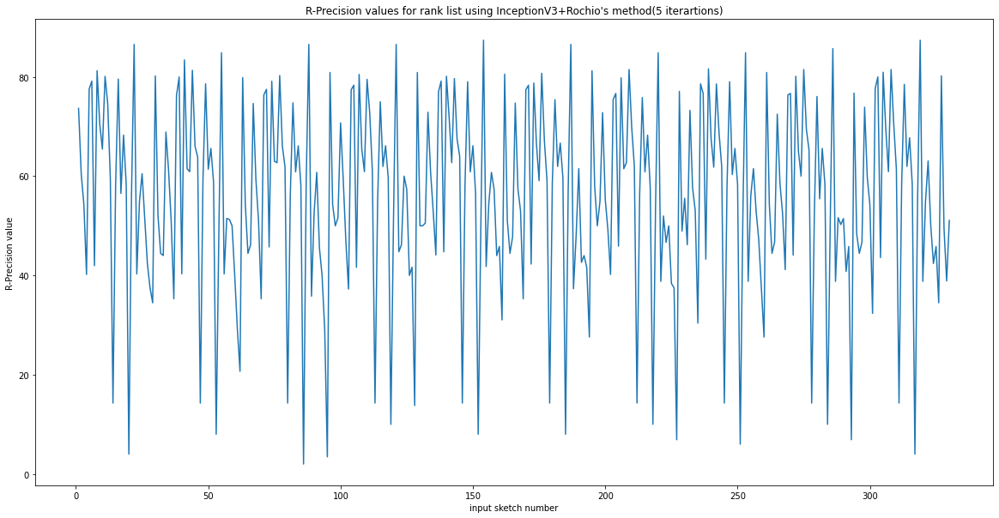

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using InceptionV3+Rochio's method(5 iterartions)")
plt.show()


##Resnet_5 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_ResNet_5.pkl','rb')
ranking_resnet=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_resnet.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_resnet)
print("MAP = "+str(map))

MAP = 63.39538012761749


In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_resnet.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[67.45788667687596, 74.4136460554371, 77.01767870868562, 71.56862745098039, 74.2782152230971, 80.83333333333333, 53.278688524590166, 76.15193026151931, 66.5, 80.0, 72.17125382262996, 70.94339622641509, 64.24625098658248, 42.857142857142854, 80.69584736251403, 81.59574468085107, 77.71739130434783, 81.18279569892472, 56.6079295154185, 26.0, 73.72093023255813, 89.91596638655463, 38.80597014925373, 60.9271523178808, 70.25641025641025, 33.82352941176471, 55.2, 33.33333333333333, 31.03448275862069, 78.81944444444444, 54.78723404255319, 55.55555555555556, 32.608695652173914, 67.3813169984686, 76.54584221748401, 75.40353574173713, 68.62745098039215, 73.49081364829397, 80.83333333333333, 49.67213114754098, 76.52552926525529, 64.0, 80.0, 70.64220183486239, 78.49056603773586, 63.45698500394633, 33.33333333333333, 77.21661054994388, 79.14893617021276, 78.80434782608695, 75.26881720430107, 57.48898678414097, 28.000000000000004, 70.69767441860465, 88.23529411764706, 38.80597014925373, 54.63576158940

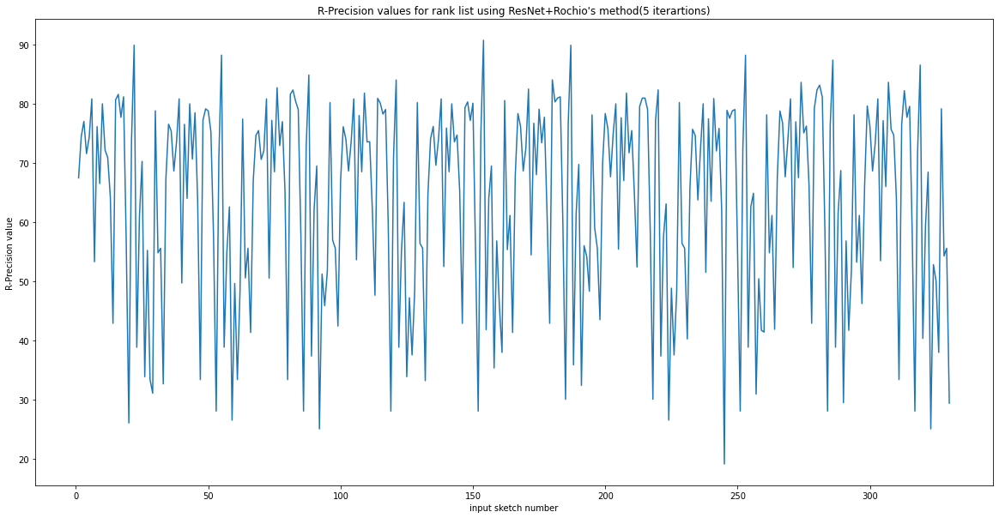

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using ResNet+Rochio's method(5 iterartions)")
plt.show()


## VGG16_4 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_VGG16_4.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 52.848692763262335


##InceptionV3_4 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_InceptionV3_4.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 62.30091257917382


##ResNet_4 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_cosine_similarity_ResNet_4.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 61.40091257917382


##VGG16_6 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_VGG16_6.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 56.150292804704726


##InceptionV3_6 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_InceptionV3_6.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 65.29119838987131


##ResNet_6 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_cosine_similarity_ResNet_6.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 64.56119838987131


**Rochio method 7 iterations**

***Cosine Similarity***

##VGG16_7 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_VGG16_7.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 56.1530836809491


In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[75.49770290964778, 62.47334754797441, 54.88086087624904, 43.13725490196079, 77.03412073490814, 80.0, 44.09836065573771, 81.94271481942715, 70.0, 70.0, 81.19266055045871, 73.20754716981132, 60.93133385951065, 14.285714285714285, 58.81032547699214, 79.8936170212766, 60.32608695652174, 68.27956989247312, 58.590308370044056, 8.0, 57.906976744186046, 88.23529411764706, 46.26865671641791, 55.4635761589404, 61.02564102564103, 52.94117647058824, 42.4, 33.33333333333333, 34.48275862068966, 81.59722222222221, 55.319148936170215, 44.44444444444444, 45.65217391304348, 71.8989280245023, 62.68656716417911, 51.96003074558032, 37.254901960784316, 76.77165354330708, 80.83333333333333, 43.77049180327869, 83.56164383561644, 63.0, 64.54545454545455, 81.80428134556576, 68.30188679245282, 64.56195737963694, 14.285714285714285, 59.70819304152637, 79.57446808510639, 61.95652173913043, 66.66666666666666, 58.81057268722467, 10.0, 51.3953488372093, 85.71428571428571, 41.7910447761194, 52.980132450331126, 54.871

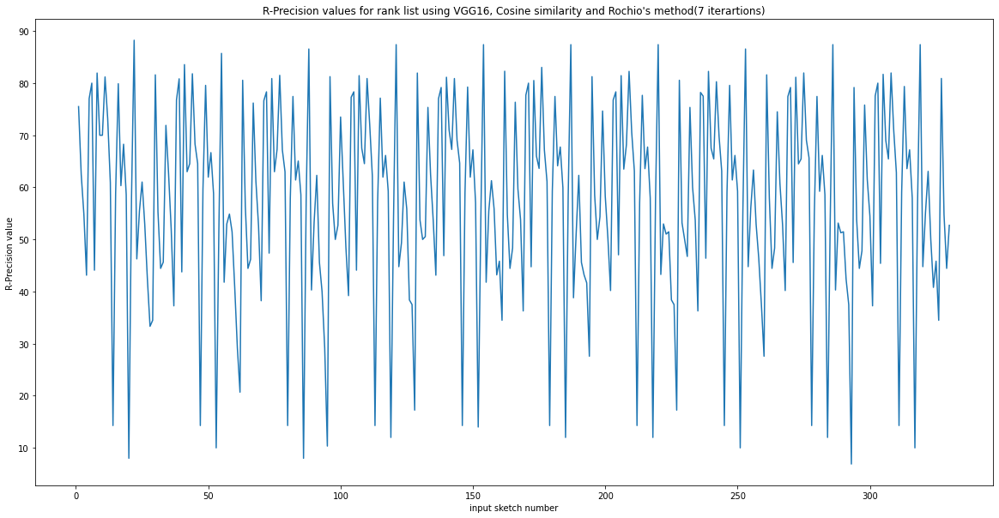

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using VGG16, Cosine similarity and Rochio's method(7 iterartions)")
plt.savefig('/content/drive/MyDrive/IR/R_Precision_Graphs/vgg16_cosine.png')
plt.show()


## InceptionV3_7 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_InceptionV3_7.pkl','rb')
ranking_inceptionV3=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_inceptionV3.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_inceptionV3)
print("MAP = "+str(map))

MAP = 67.38912734403601


In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_inceptionV3.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[65.69678407350689, 78.57142857142857, 68.63950807071484, 74.50980392156863, 77.16535433070865, 90.0, 54.91803278688525, 80.57285180572852, 65.5, 80.0, 73.24159021406727, 81.88679245283019, 51.38121546961326, 76.19047619047619, 90.23569023569024, 84.25531914893617, 80.43478260869566, 82.79569892473118, 52.20264317180616, 30.0, 70.23255813953489, 93.27731092436974, 37.3134328358209, 68.21192052980133, 59.23076923076923, 39.705882352941174, 41.6, 54.166666666666664, 58.620689655172406, 88.88888888888889, 64.8936170212766, 55.55555555555556, 39.130434782608695, 64.24196018376723, 80.17057569296375, 67.33282090699461, 75.49019607843137, 74.54068241469817, 86.66666666666667, 53.442622950819676, 81.00871731008718, 64.0, 80.9090909090909, 73.70030581039755, 80.37735849056604, 53.27545382794001, 80.95238095238095, 90.68462401795735, 84.14893617021276, 81.52173913043478, 71.50537634408603, 51.3215859030837, 30.0, 72.32558139534883, 91.59663865546219, 34.32835820895522, 69.03973509933775, 53.333

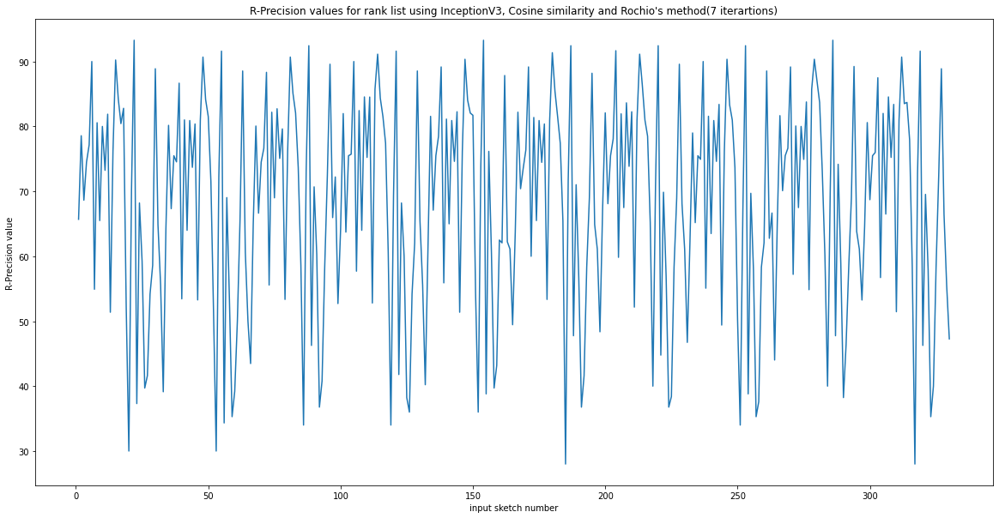

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using InceptionV3, Cosine similarity and Rochio's method(7 iterartions)")
plt.savefig('/content/drive/MyDrive/IR/R_Precision_Graphs/inceptionV3_cosine.png')
plt.show()


##ResNet_7 cosine

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_ResNet_7.pkl','rb')
ranking_resnet=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_resnet.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_resnet)
print("MAP = "+str(map))

MAP = 65.35630734957341


In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_resnet.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[67.68759571209802, 77.18550106609808, 77.70945426594928, 70.58823529411765, 75.19685039370079, 80.83333333333333, 54.75409836065573, 77.3972602739726, 68.0, 80.0, 74.15902140672783, 73.58490566037736, 65.03551696921863, 42.857142857142854, 81.3692480359147, 82.65957446808511, 78.80434782608695, 82.25806451612904, 59.25110132158591, 28.000000000000004, 76.74418604651163, 89.91596638655463, 41.7910447761194, 62.58278145695364, 71.7948717948718, 33.82352941176471, 55.2, 41.66666666666667, 44.827586206896555, 80.20833333333334, 57.446808510638306, 61.111111111111114, 39.130434782608695, 67.15160796324655, 79.1044776119403, 76.01844734819369, 69.6078431372549, 74.80314960629921, 80.83333333333333, 52.622950819672134, 77.95765877957659, 66.0, 80.0, 73.70030581039755, 78.8679245283019, 64.24625098658248, 33.33333333333333, 78.00224466891133, 80.74468085106383, 78.80434782608695, 78.49462365591397, 58.81057268722467, 28.000000000000004, 75.11627906976744, 88.23529411764706, 40.298507462686565

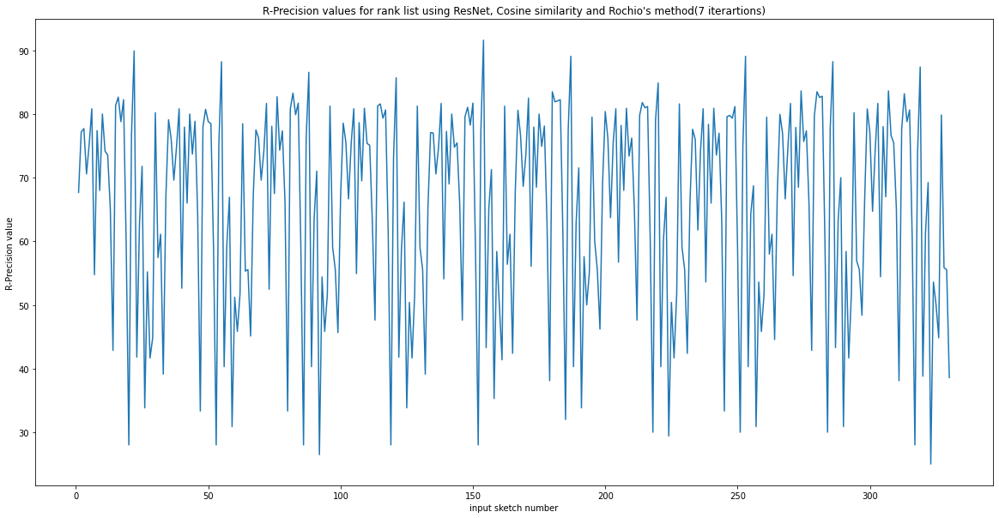

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using ResNet, Cosine similarity and Rochio's method(7 iterartions)")
plt.savefig('/content/drive/MyDrive/IR/R_Precision_Graphs/ResNet_cosine.png')
plt.show()


***Euclidian Distance***

## VGG16_3 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_VGG16_3.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 40.25070791506288


##InceptionV3_3 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_InceptionV3_3.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 54.74519544989294


##ResNet_3 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_ResNet_3.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 55.92777754441716


##VGG16_4 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_VGG16_4.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 37.65413414062314


##InceptionV3_4 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_InceptionV3_4.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 56.12476427283022


##ResNet_4 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_ResNet_4.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 57.67476427283022


## VGG16_5 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_VGG16_5.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 35.231743604302046


##InceptionV3_5 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_InceptionV3_5.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 59.06943214371206


##ResNet_5 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_ResNet_5.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 57.94240506617112


## VGG16_6 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_VGG16_6.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 31.99589421827739


##InceptionV3_6 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_InceptionV3_6.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 58.25386606062372


##ResNet_6 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_ResNet_6.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 57.68986606062372


##VGG16_7 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_VGG16_7.pkl','rb')
ranking_vgg16=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_vgg16)
print("MAP = "+str(map))

MAP = 31.99425356684933


In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_vgg16.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[63.24655436447168, 20.149253731343283, 40.35357417371253, 28.431372549019606, 66.7979002624672, 60.0, 18.524590163934427, 77.08592777085927, 53.5, 48.18181818181818, 73.85321100917432, 54.339622641509436, 40.64719810576164, 0.0, 22.44668911335578, 65.74468085106383, 20.108695652173914, 54.83870967741935, 38.76651982378855, 14.000000000000002, 25.348837209302328, 78.15126050420169, 22.388059701492537, 28.311258278145697, 23.589743589743588, 32.35294117647059, 12.0, 4.166666666666666, 3.4482758620689653, 70.83333333333334, 32.4468085106383, 0.0, 7.608695652173914, 59.264931087289426, 20.68230277185501, 37.7401998462721, 21.568627450980394, 67.06036745406824, 58.333333333333336, 17.868852459016395, 79.32752179327521, 43.0, 46.36363636363636, 75.84097859327217, 49.43396226415094, 43.409629044988165, 0.0, 23.793490460157127, 65.1063829787234, 22.82608695652174, 53.2258064516129, 40.08810572687225, 18.0, 20.46511627906977, 75.63025210084034, 22.388059701492537, 27.64900662251656, 21.7948717

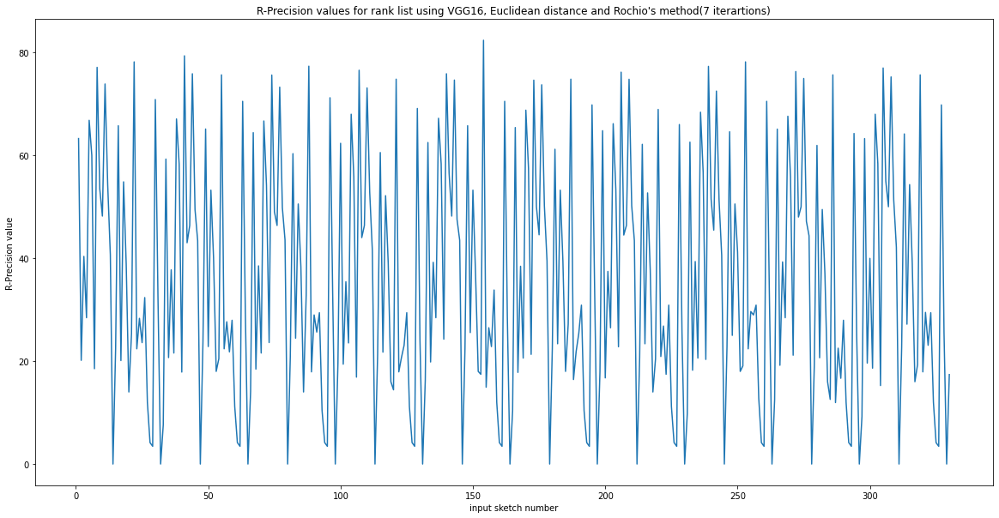

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using VGG16, Euclidean distance and Rochio's method(7 iterartions)")
plt.savefig('/content/drive/MyDrive/IR/R_Precision_Graphs/vgg16_euclidean.png')
plt.show()


## InceptionV3_7 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_InceptionV3_7.pkl','rb')
ranking_inceptionV3=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_inceptionV3.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_inceptionV3)
print("MAP = "+str(map))

MAP = 58.65758225737865


In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_inceptionV3.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[59.724349157733535, 69.5095948827292, 62.41352805534205, 74.50980392156863, 72.83464566929135, 85.83333333333333, 50.65573770491804, 77.89539227895392, 59.0, 59.09090909090909, 64.98470948012233, 69.0566037735849, 51.38121546961326, 66.66666666666666, 85.0729517396184, 78.93617021276596, 54.347826086956516, 68.27956989247312, 53.08370044052864, 20.0, 65.34883720930232, 84.03361344537815, 22.388059701492537, 56.12582781456954, 60.0, 47.05882352941176, 34.4, 33.33333333333333, 62.06896551724138, 86.45833333333334, 49.46808510638298, 44.44444444444444, 30.978260869565215, 58.575803981623274, 74.09381663113007, 62.182936202920835, 73.52941176470588, 67.97900262467192, 80.83333333333333, 49.67213114754098, 78.08219178082192, 57.99999999999999, 60.0, 66.97247706422019, 66.41509433962264, 54.38042620363063, 66.66666666666666, 86.19528619528619, 77.55319148936171, 61.95652173913043, 47.8494623655914, 51.98237885462555, 22.0, 69.30232558139535, 77.31092436974791, 20.8955223880597, 58.278145695

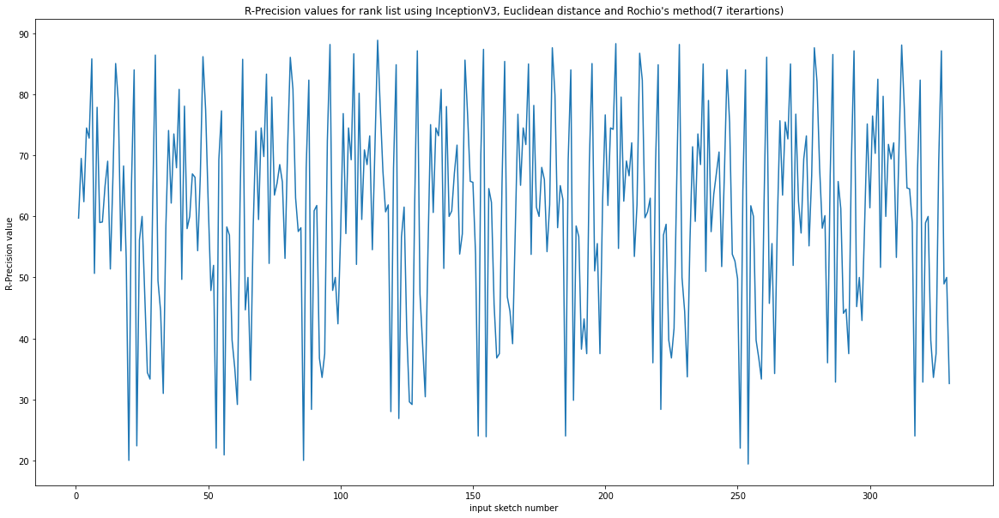

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using InceptionV3, Euclidean distance and Rochio's method(7 iterartions)")
plt.savefig('/content/drive/MyDrive/IR/R_Precision_Graphs/inceptionV3_euclidean.png')
plt.show()


## ResNet_7 euclidian

In [ ]:
import pickle
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_ResNet_7.pkl','rb')
ranking_resnet=pickle.load(file)
file.close()

In [ ]:
map=0
for filename,value in ranking_resnet.items():
  index=filename.split('/')
  recall,precision=compute_MAP(sketch_ground_truth[int(index[1])],value)
  map+=AP(recall,precision)
  # print(recall)
  # break
  # c+=1
map/=len(ranking_resnet)
print("MAP = "+str(map))

MAP = 57.26641973376724


In [ ]:
res=[]
c=0
y=[]
for filename,value in ranking_resnet.items():
  index=filename.split('/')
  r=R_Precision(sketch_ground_truth[int(index[1])],value)
  res.append(r*100)
  y.append(c+1)
  c+=1
  # print(recall)
  # break
  # c+=1
print(res)

[65.16079632465544, 69.18976545842217, 72.79016141429669, 54.90196078431373, 76.64041994750657, 80.0, 49.34426229508197, 75.21793275217932, 65.5, 70.9090909090909, 65.59633027522935, 63.0188679245283, 65.27229676400947, 28.57142857142857, 74.97194163860831, 76.70212765957447, 70.65217391304348, 79.03225806451613, 51.3215859030837, 20.0, 66.97674418604652, 89.91596638655463, 38.80597014925373, 53.973509933774835, 64.35897435897436, 30.88235294117647, 39.2, 37.5, 34.48275862068966, 76.38888888888889, 53.72340425531915, 44.44444444444444, 14.130434782608695, 64.08882082695253, 72.06823027718549, 71.48347425057648, 50.98039215686274, 76.11548556430446, 80.83333333333333, 47.868852459016395, 75.40473225404732, 67.5, 70.9090909090909, 64.83180428134557, 67.16981132075472, 64.87766377269139, 33.33333333333333, 74.85970819304153, 75.95744680851064, 70.1086956521739, 75.80645161290323, 53.08370044052864, 22.0, 65.11627906976744, 89.07563025210085, 38.80597014925373, 52.152317880794705, 50.25641

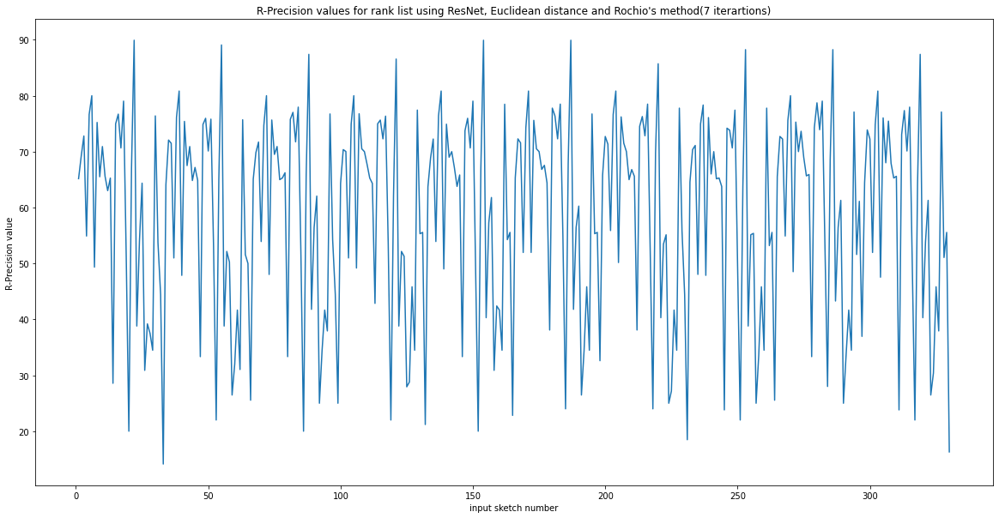

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(y,res)
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using ResNet, Euclidean distance and Rochio's method(7 iterartions)")
plt.savefig('/content/drive/MyDrive/IR/R_Precision_Graphs/resnet_euclidean.png')
plt.show()


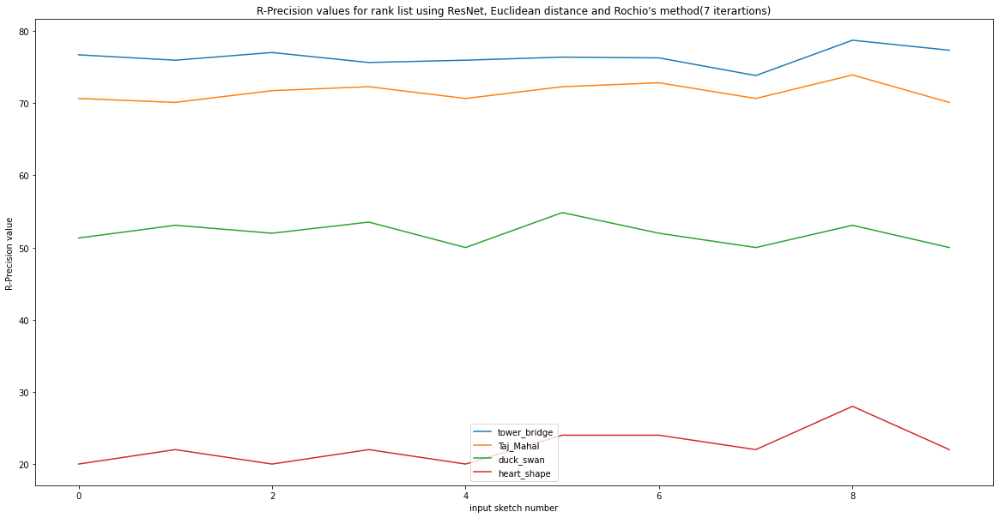

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))

x = [i for i in range(10)]
y1 = [res[i] for i in range(15, len(res), 33)]
y2 = [res[i] for i in range(16, len(res), 33)]
y3 = [res[i] for i in range(18, len(res), 33)]
y4 = [res[i] for i in range(19, len(res), 33)]
# print(res)

plt.plot(x, y1, label = title_list[16][0])
plt.plot(x, y2, label = title_list[17][0])
plt.plot(x, y3, label = title_list[19][0])
plt.plot(x, y4, label = title_list[20][0])
plt.xlabel("input sketch number")
plt.ylabel("R-Precision value")
plt.title("R-Precision values for rank list using ResNet, Euclidean distance and Rochio's method(7 iterartions)")
# plt.savefig('/content/drive/MyDrive/IR/R_Precision_Graphs/resnet_euclidean.png')
plt.legend()
plt.show()


In [ ]:
len(title_list)
# title_list

{1: ['fire_balloon', 'London_eye', 'moon', 'mushroom', 'others', 'paris'],
 2: ['Brussel_Cathedral', 'notre_dame_paris', 'Westminster_Abbey'],
 3: ['Egypt_pyramid',
  'El_Castillo_mexico',
  'Louvre',
  'pyramid',
  'Venice_pyramid'],
 4: ['starfish'],
 5: ['London_TrafalgarSquare',
  'Madeleine_church',
  'Pantheon',
  'paris',
  'Paris_Pantheon',
  'Rome_Pantheon'],
 6: ['bicycle'],
 7: ['Burj_Al_Arab', 'sailling'],
 8: ['eiffel_tower'],
 9: ['airplane'],
 10: ['koeln_dom'],
 11: ['China_tower', 'Pisa_tower'],
 12: ['flower', 'sunflower'],
 13: ['big_ben'],
 14: ['horse'],
 15: ['Arc_de_Triomphe',
  'Indian_arch',
  'london_arch',
  'New_York_arch',
  'Place_du_Carrousel',
  'romania_arch',
  'Rome_archofconstantine'],
 16: ['tower_bridge'],
 17: ['Taj_Mahal'],
 18: ['Oxford_bridge', 'Venice_bridge'],
 19: ['duck_swan'],
 20: ['heart_shape'],
 21: ['Temple_of_Heaven_beijing'],
 22: ['Shanghai_TV_tower'],
 23: ['butterfly'],
 24: ['Colosseum'],
 25: ['sunset_sunrise'],
 26: ['bird'],


**P@10 and R@10**

VGG16

In [ ]:
def PR10(actual,ranking):
  precision=0
  recall=0
  count=0;
  n=len(actual)
  for i in range(10):
    
    arr=ranking[i][0].split('.')
    
    if arr[0] in actual:
      count+=1
  recall=count/n
  precision=count/10
      # recall[count/n]=count/(i+1)
      # print(count,i)
    
  return (recall,precision)

In [ ]:
import matplotlib.pyplot as plt

def computePR10(features):
  precision=[]
  recall=[]
  print("Calculating P@10 and R@10")
  for i in range(len(features)):
    temp_recall=[]
    temp_precision=[]
    for filename,value in features[i].items():
      index=filename.split('/')
      r,p=PR10(sketch_ground_truth[int(index[1])],value)
      temp_precision.append(p*100)
      temp_recall.append(r*100)
    precision.append(temp_precision)
    recall.append(temp_recall)
    print("==",end="")
  print(">")
  print("Calculation Done")
  print("Ploting graphs")
  plt.figure(figsize=(20,10))
  y = [i for i in range(50)]
  plt.plot(y, precision[0][:50], label = "VGG16 + Cosine Similarity" )
  plt.plot(y, precision[2][:50], label = "InceptionV3 + Cosine Similarity" )
  plt.plot(y, precision[4][:50], label = "ResNet + Cosine Similarity" )
  plt.xlabel("input sketch number")
  plt.ylabel("Precision@10 value")
  plt.title("Precision@10 values for the generated rank list using Cosine Similarity")
  plt.legend()
  plt.savefig('/content/drive/MyDrive/IR/Graphs/precision_10_cosine.png')
  # plt.legend()
  plt.show()

  plt.figure(figsize=(20,10))
  plt.plot(y, precision[1][:50], label = "VGG16 + Euclidean Distance" )
  plt.plot(y, precision[3][:50], label = "InceptionV3 + Euclidean Distance" )
  plt.plot(y, precision[5][:50], label = "ResNet + Euclidean Distance" )
  plt.xlabel("input sketch number")
  plt.ylabel("Precision@10 value")
  plt.title("Precision@10 values for the generated rank list using Euclidean Distance")
  plt.legend()
  plt.savefig('/content/drive/MyDrive/IR/Graphs/precision_10_euclidean.png')
  plt.show()

  plt.figure(figsize=(20,10))
  plt.plot(y, recall[0][:50], label = "VGG16 + Cosine Similarity" )
  plt.plot(y, recall[2][:50], label = "InceptionV3 + Cosine Similarity" )
  plt.plot(y, recall[4][:50], label = "ResNet + Cosine Similarity" )
  plt.xlabel("input sketch number")
  plt.ylabel("Recall@10 value")
  plt.title("Recall@10 values for the generated rank list using Cosine Similarity")
  plt.legend()
  plt.savefig('/content/drive/MyDrive/IR/Graphs/recall_10_cosine.png')
  plt.show()

  plt.figure(figsize=(20,10))
  plt.plot(y, recall[1][:50], label = "VGG16 + Euclidean Distance" )
  plt.plot(y, recall[3][:50], label = "InceptionV3 + Euclidean Distance" )
  plt.plot(y, recall[5][:50], label = "ResNet + Euclidean Distance" )
  plt.xlabel("input sketch number")
  plt.ylabel("Recall@10 value")
  plt.title("Recall@10 values for the generated rank list using Euclidean Distance")
  plt.legend()
  plt.savefig('/content/drive/MyDrive/IR/Graphs/recall_10_euclidean.png')
  # plt.legend()
  plt.show()

loading features
feature loading done
Calculating P@10 and R@10
============>
Calculation Done
Ploting graphs


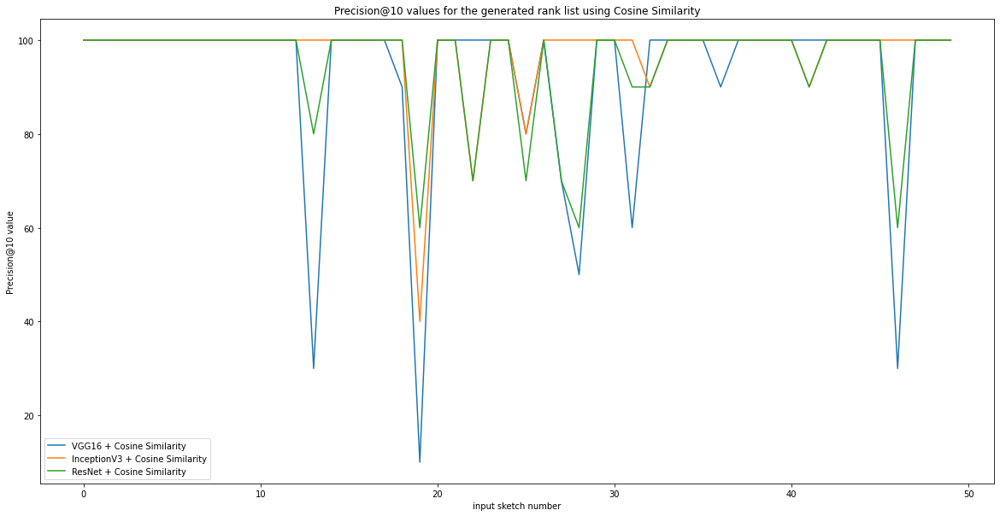

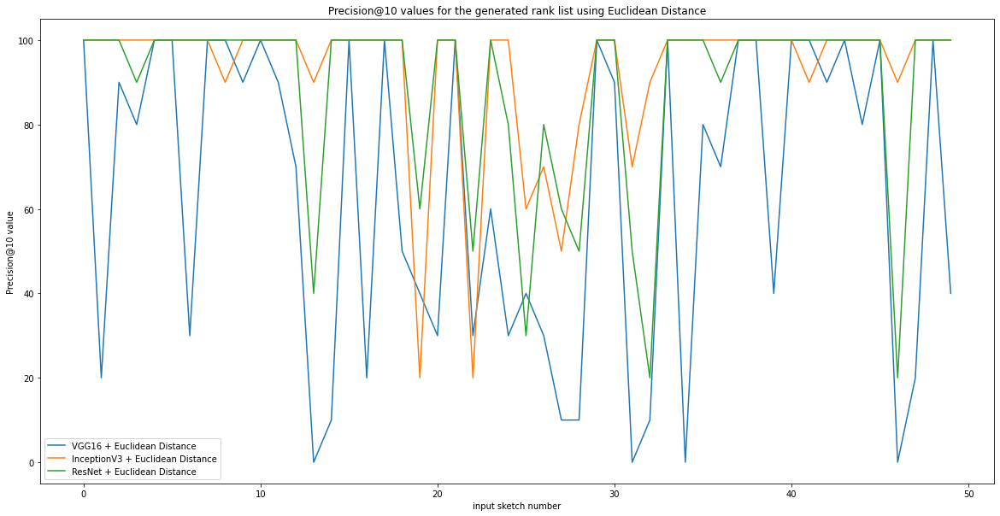

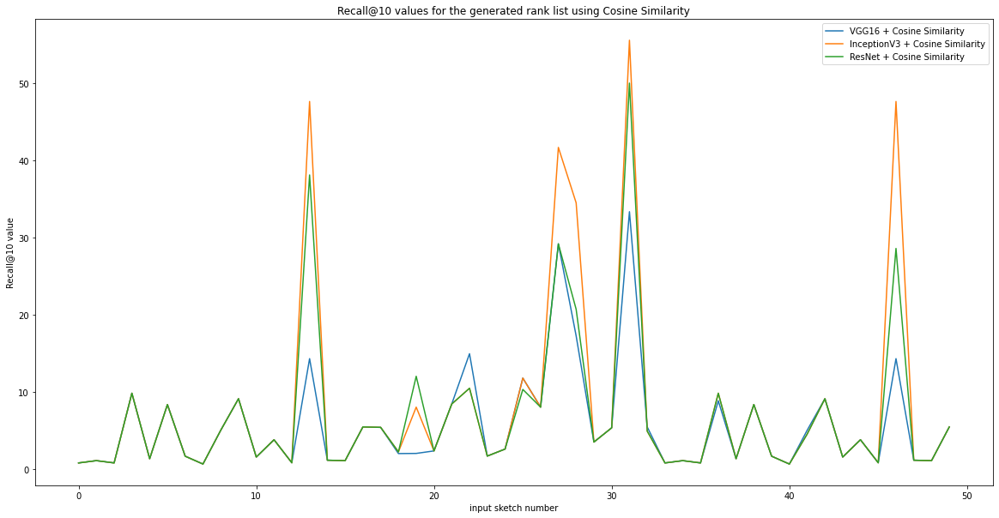

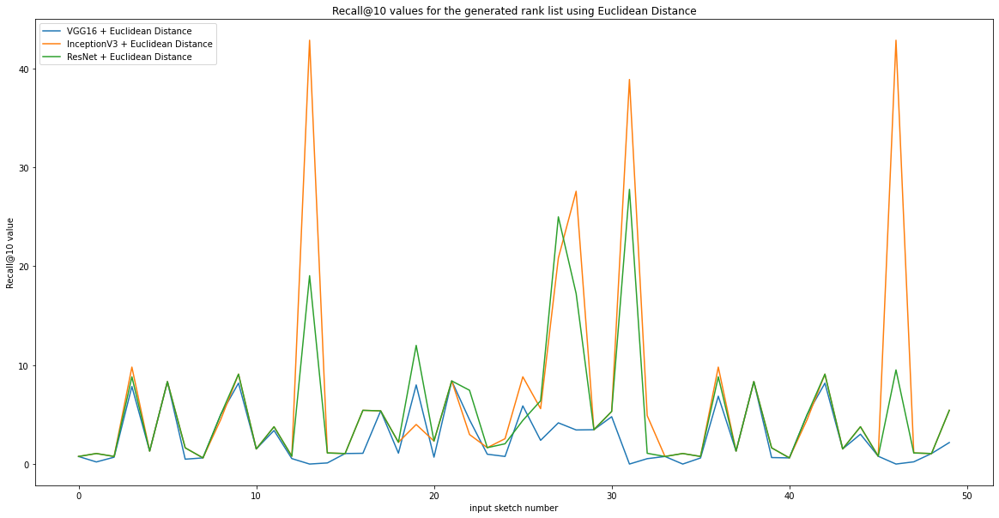

In [ ]:
import pickle
features=[]
print("loading features")
file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_VGG16_7.pkl','rb')
features.append(pickle.load(file))
file.close()

file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_VGG16_7.pkl','rb')
features.append(pickle.load(file))
file.close()

file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_InceptionV3_7.pkl','rb')
features.append(pickle.load(file))
file.close()

file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_InceptionV3_7.pkl','rb')
features.append(pickle.load(file))
file.close()

file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_ResNet_7.pkl','rb')
features.append(pickle.load(file))
file.close()

file=open('/content/drive/MyDrive/IR/new_Ranking/newSketchRanking_euclidean_distances_ResNet_7.pkl','rb')
features.append(pickle.load(file))
file.close()
print('feature loading done')

computePR10(features)

Outputs examples


Populating the interactive namespace from numpy and matplotlib


/usr/local/lib/python3.6/dist-packages/IPython/core/magics/pylab.py:161: UserWarning: pylab import has clobbered these variables: ['arrow']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


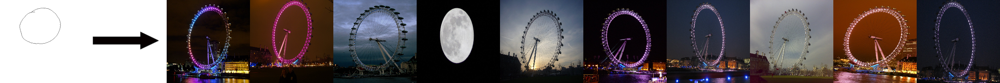

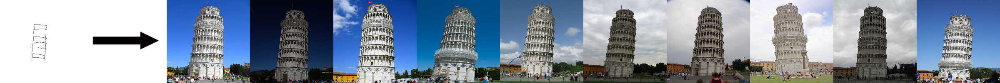

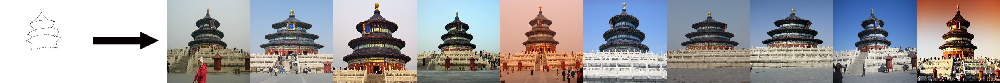

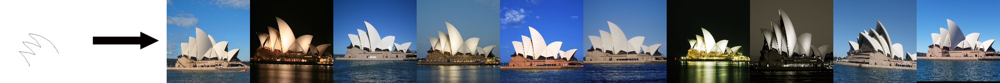

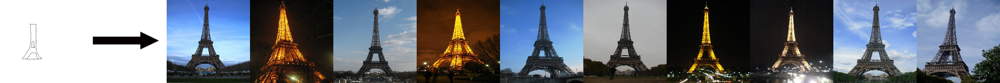

...

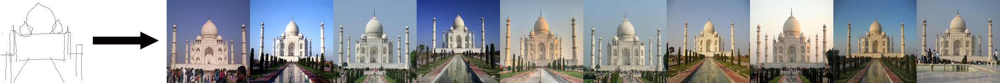

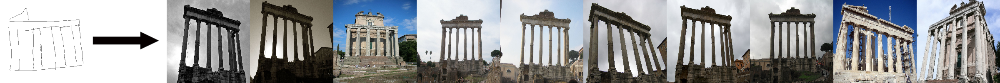

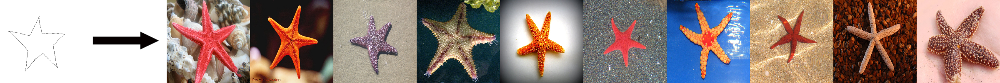

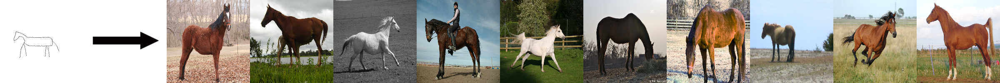

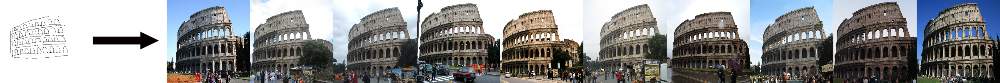

True

In [ ]:
%pylab inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
count=0
final=[]
for filename,value in ranking_inceptionV3.items():
  # index=filename.split('/')
  # input_sk = mpimg.imread("/content/drive/My Drive/IR/Flickr15K/sketches/"+filename+".png")
  # imgplot = plt.imshow(img)
  # plt.show()
  # # r=R_Precision(sketch_ground_truth[int(index[1])],value)
  # horizontal1=
  # for i in range(5):
  #   img = mpimg.imread("/content/drive/My Drive/IR/Flickr15K/images/"+value[i][0]+".jpg")
  #   imgplot = plt.imshow(img)
  #   plt.show()
  if count%10==0:
    input_sk = cv2.imread("/content/drive/My Drive/IR/Flickr15K/sketches/"+filename+".png")
    input_sk = cv2.resize(input_sk,(200,200))
    arrow = cv2.imread("/content/drive/My Drive/IR/arrow.png")
    arrow = cv2.resize(arrow,(200,200))
    output_img = []
    for i in range(10):
      temp= cv2.imread("/content/drive/My Drive/IR/Flickr15K/images/"+value[i][0]+".jpg")
      output_img.append(cv2.resize(temp,(200,200)))
    hori=np.hstack(output_img)
    hori1=np.hstack([input_sk,arrow])
    hor2=np.hstack([hori1,hori])
    final.append(hor2)
    cv2_imshow(hor2)
  
  count+=1

final1=final[:10]
final2=final[10:20]
final3=final[20:30]
vert1=np.vstack(final1)
vert2=np.vstack(final2)
vert3=np.vstack(final3)
cv2.imwrite("/content/drive/My Drive/IR/Result1.png",vert1)
cv2.imwrite("/content/drive/My Drive/IR/Result2.png",vert2)
cv2.imwrite("/content/drive/My Drive/IR/Result3.png",vert3)

In [ ]:
vert=np.vstack(final)
cv2.imwrite("/content/drive/My Drive/IR/Sample Results/combinedResult.png",vert)

True

In [ ]:
len(final)

33